<a href="https://colab.research.google.com/github/bhaskarsaripella4/AgenticAI_python/blob/main/Grocery_store_image_search_classificationV2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This project will create an Agent that will chat with the user asking for his required product. It will lookup the database for the item and check for its availability. Then it will search for that item's image and return an annotated image where the item is located on an isle.

Firstly, develop the Image Ingestion and Classification Tool. The high-level plan is:

The tool will accept an image (file path or URL).

It will classify the image using a pre-trained model.

Finally it will return the classification label(s).

We will use a simple image classification model like torchvision’s pretrained ResNet or TensorFlow/Keras model for this.

Secondly, We'll provide a query like "Show me fruits" or "How many milk cartons?".

The tool vectorizes the query and searches the grocery inventory database to find matching products and their quantities.

It will return relevant inventory info matching the query.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install faiss-cpu
# Install YOLOv5 dependencies if needed
!pip install -q torch torchvision
!pip install -q opencv-python-headless
!pip install -q matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 31.3/31.3 MB 51.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 89.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 74.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 39.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 66.7 MB/s eta 0:00:00


In [3]:
import torch
import torchvision.transforms as transforms
from torchvision.models import mobilenet_v2
from PIL import Image
import requests
from io import BytesIO
import os
from sentence_transformers import SentenceTransformer
import faiss
import numpy as np
import cv2
from IPython.display import display

Sample Inventory with items and their metadata.

In [18]:
class GroceryInventory:
    def __init__(self):
        # Sample grocery inventory data
        # Each item has a name, category, and quantity
        self.inventory = [
            {"name": "banana", "category": "banana", "class":"banana", "quantity": 50},
            {"name": "apple", "category": "fruit", "class": "apple", "quantity": 30},
            {"name": "carrot", "category": "vegetable1", "class": "carrot","quantity": 20},
            {"name": "milk carton", "category": "milk/dairy","class": "bottle", "quantity": 15},
            {"name": "chocolate bar", "category": "processed food","class": "cake", "quantity": 40},
            {"name": "sauce bottle", "category": "processed food","class": "bottle", "quantity": 25},
            {"name": "broccoli", "category": "vegetable", "class": "broccoli","quantity": 10},
            {"name": "orange", "category": "fruit","class": "orange", "quantity": 18},
            # Add more products as needed
        ]

        self.grocery_images = [
        {"category": "vegetable1", "aisle": 2, "image_url": "/content/drive/MyDrive/Datasets/Images/assorted_fruits_shelf.jpg"},
        {"category":"banana", "aisle": 3, "image_url": "/content/drive/MyDrive/Datasets/Images/Banana-Single.jpg"},
        {"category": "fruit", "aisle": 1, "image_url": "/content/drive/MyDrive/Datasets/Images/assorted_fruits1_shelf.jpg"},
        {"category": "vegetable", "aisle": 4, "image_url": "/content/drive/MyDrive/Datasets/Images/assorted_leafy_shelf.jpg"},
        {"category": "processed food", "aisle": 7, "image_url": "/content/drive/MyDrive/Datasets/Images/bars_shelf1.jpg"},
        {"category": "processed food", "aisle": 6, "image_url": "/content/drive/MyDrive/Datasets/Images/pringles_shelf1.jpg"},
        {"category": "milk/dairy", "aisle": 5, "image_url": "/content/drive/MyDrive/Datasets/Images/milk_shelf.jpg"}
        ]

    def get_item_instore(self, item_name):

      item = next((i for i in self.inventory if i["name"] == item_name),None)
      if not item:
        return "Item not found in Store"


      item_metadata = next((i for i in self.grocery_images if i["category"] == item["category"]), None)

      if not item_metadata:
        return {
          "name": item["name"],
          "category": item["category"],
          "class": item["class"],
          "quantity": item["quantity"],
          "aisle": None,
          "image_url": None
      }

      return {
          "name": item["name"],
          "category": item["category"],
          "class": item["class"],
          "quantity": item["quantity"],
          "aisle": item_metadata["aisle"],
          "image_url": item_metadata["image_url"]
      }

      def get_inventory(self):
        return self.inventory

Use a pretrained Yolo V5 model to create a bounding box on the image that is selected.

In [35]:
class Utils:
  def __init__(self):
    self.model = None
    self.product_embeddings = None
    self.index = None
    self.detector = None
    self.coco_classes = None

  def _download_image(self, url):
    if url and (url.startswith("http://") or url.startswith("https://")):
      resp = requests.get(url)
      img = Image.open(BytesIO(resp.content)).convert("RGB")
    else:
      if not os.path.exists(url):
        raise FileNotFoundError(f"File not found: {url}")
      img = Image.open(url).convert("RGB")

    return img


  def _draw_bounding_boxes(self, img, boxes, labels):
    #Convert PIL RGB -> OpenCV BGR
    cv_img = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)

    print(f"Drawing {len(boxes)} bounding boxes") # logging if any boxes found

    for box, label in zip(boxes, labels):
      x1, y1, x2, y2 = map(int, box) #make sure coordinates are int
      print(f"Box coords: {x1},{y1},{x2},{y2} Label: {label}") # logging boxes

      cv2.rectangle(cv_img, (x1,y1), (x2,y2), (0,255,0), 3) #Green box with 3 thickness
      cv2.putText(cv_img, label, (x1,y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,255,0), 2)

    #Convert back to PIL RGB
    return Image.fromarray(cv2.cvtColor(cv_img, cv2.COLOR_BGR2RGB))


  def find_items_in_image(self, img, img_result, target_class, scale_x, scale_y):

    detected_boxes = []
    detected_labels = []
    for *box, conf, cls in img_result.xyxy[0].cpu().numpy():
      class_id = int(cls)
      label = self.coco_classes[class_id].lower()
      if label == target_class and conf >= self.detector.conf:
        x1,y1,x2,y2 = box
        scaled_box = [x1*scale_x, y1*scale_y, x2*scale_x, y2*scale_y]

        detected_boxes.append(scaled_box)
        detected_labels.append(label.title())

    return detected_boxes, detected_labels


  def vectorize_labels(self, items):
    self.model = SentenceTransformer('all-MiniLM-L6-v2')
    product_names = [item["name"] for item in items]
    self.product_embeddings = self.model.encode(product_names, convert_to_numpy=True)
    dim = self.product_embeddings.shape[1]
    self.index = faiss.IndexFlatL2(dim)
    self.index.add(self.product_embeddings)


  def load_img_model(self):
    self.detector = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained = True)
    self.detector.cpu()
    self.detector.eval()
    self.detector.conf = 0.1

    #COCO class names Yolo V5
    self.coco_classes = self.detector.names

    return self.detector, self.coco_classes



Run vectorization and detection on images for a given item

In [36]:
class StoreSearchClassifier:
  def __init__ (self, utils, inventory):
    self.utils = utils
    self.inventory = inventory
    self.detector, self.coco_classes = utils.load_img_model()
    utils.vectorize_labels(self.inventory.inventory)
    self.index = utils.index
    self.model = utils.model


  def use(self, *args):
    if not args:
            return "Please provide a search query."

    query = args[0]

    #Vector search to find best matching product
    query_embedding = self.model.encode([query], convert_to_numpy=True)
    D,I = self.index.search(query_embedding, 1) #top 1
    print("shape of I: ",I)
    idx = I[0][0]
    product = self.inventory.inventory[idx]

    print(product)

    #Download shelf image for this product
    result_item = self.inventory.get_item_instore(product["name"])
    print(f"result item for product {product} is {result_item}")
    url = result_item["image_url"]
    print(f"url: {url}")
    img = self.utils._download_image(url)

        # Run YOLOv5 detection
    img_resized = img.resize((640, 640))
    results = self.detector(img_resized)
    print(img.size)
    orig_w, orig_h = img.size
    scale_x = orig_w / 640
    scale_y = orig_h / 640
    target_class = product["class"].lower()
    detected_boxes, detected_labels = self.utils.find_items_in_image(img, results, target_class, scale_x, scale_y)

    if detected_boxes:
      img_annotated = self.utils._draw_bounding_boxes(img, detected_boxes, detected_labels)
    else:
      img_annotated = img  # No detected boxes, return original image

    display(img_annotated)



Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2025-6-5 Python-3.11.12 torch-2.6.0+cu124 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


shape of I:  [[7]]
{'name': 'orange', 'category': 'fruit', 'class': 'orange', 'quantity': 18}
result item for product {'name': 'orange', 'category': 'fruit', 'class': 'orange', 'quantity': 18} is {'name': 'orange', 'category': 'fruit', 'class': 'orange', 'quantity': 18, 'aisle': 1, 'image_url': '/content/drive/MyDrive/Datasets/Images/assorted_fruits1_shelf.jpg'}
url: /content/drive/MyDrive/Datasets/Images/assorted_fruits1_shelf.jpg


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


(4032, 3024)
Drawing 7 bounding boxes
Box coords: 25,403,1197,933 Label: Orange
Box coords: 36,2015,1391,2726 Label: Orange
Box coords: 0,1240,1332,1828 Label: Orange
Box coords: 2766,1813,2900,1927 Label: Orange
Box coords: 2213,1692,3077,2148 Label: Orange
Box coords: 768,1,1206,77 Label: Orange
Box coords: 4,449,391,914 Label: Orange


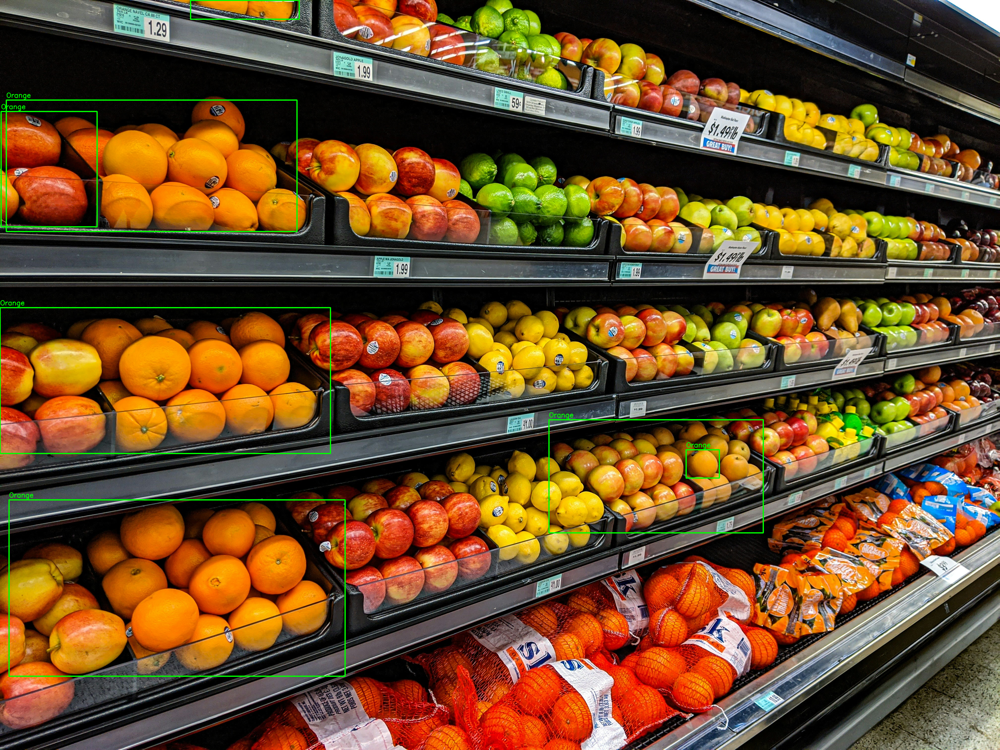

In [37]:
# Example usage
if __name__ == "__main__":
    inventory = GroceryInventory()
    utils = Utils()
    tool = StoreSearchClassifier(utils, inventory)
    # product_query = "broccoli"
    product_query = "orange"
    # product_query = "milk"
    # info, annotated_img =
    tool.use(product_query, utils, inventory)

    # print(info)
    # display(annotated_img)  # Opens image viewer with bounding boxes drawn